# Spatio-Temporal Modeling with Convolutional Neural Networks

In this notebook, I will attempt to build a CNN model that will predict drought levels for all locations across the contiguous United States based on past data points. Each data point in the weekly time series consists of a rectangular grid where each point on the grid has an associated numerical value reflecting drought levels.

## Intitial Model
### X: 8 immediately preceding data points
### 25 epochs

In [1]:
import pandas as pd
import numpy as np
import datetime as dt
import matplotlib.pyplot as plt

np.random.seed(42)

from sklearn.model_selection import train_test_split
from keras.models import Sequential
from keras.layers import Dense, Dropout, Activation, Flatten
from keras.layers import Conv2D, MaxPooling2D, Conv3D, MaxPooling3D
from keras.utils import np_utils

%matplotlib inline

Using TensorFlow backend.


In [2]:
drought_array = pd.read_csv("./data/drought_simplified_array.csv")

In [3]:
drought_array.drop(columns="Unnamed: 0", inplace=True)

In [4]:
drt = pd.read_csv("./data/drought_data_combined.csv")

drt.set_index("Date", inplace=True)

drt.index = pd.to_datetime(drt.index)

In [5]:
latitudes = [0.25*i for i in list(range(96, 201))]
latitudes.reverse()

longitudes = [0.25*i for i in list(range(-500, -263))]

dates = list(drt.index.unique().sort_values())

In [6]:
drought_3D = drought_array.values.reshape(len(dates), len(latitudes), len(longitudes))

In [7]:
drought_3D.shape

(1009, 105, 237)

In [8]:
drought_3D[8:].shape

(1001, 105, 237)

In [9]:
drought_3D[:-8].shape

(1001, 105, 237)

In [10]:
# lag = 4 weeks
X = np.array([])
for i in range(drought_3D[:-8].shape[0]):
    data_point = np.array([drought_3D[i], drought_3D[i+1], drought_3D[i+2], drought_3D[i+3],
                           drought_3D[i+4], drought_3D[i+5], drought_3D[i+6], drought_3D[i+7]])
    X = np.append(X, data_point)

In [11]:
X.shape

(199279080,)

In [12]:
X_matrix = X.reshape(1001, 8, 105, 237, 1)

In [13]:
X_matrix.shape

(1001, 8, 105, 237, 1)

In [14]:
105*237

24885

In [16]:
Y = drought_3D[8:].reshape(1001, 24_885)

In [17]:
Y.shape

(1001, 24885)

In [18]:
X_train = X_matrix[:725]
X_test  = X_matrix[725:]
Y_train = Y[:725]
Y_test  = Y[725:]

In [19]:
X_train.shape

(725, 8, 105, 237, 1)

In [20]:
X_test.shape

(276, 8, 105, 237, 1)

In [21]:
Y_train.shape

(725, 24885)

In [22]:
Y_test.shape

(276, 24885)

In [23]:
def r2_score(y_true, y_pred):
    from keras import backend as K
    SS_res =  K.sum(K.square( y_true-y_pred ))
    SS_tot = K.sum(K.square( y_true - K.mean(y_true) ) )
    return ( 1 - SS_res/(SS_tot + K.epsilon()) )

In [24]:
cnn_model = Sequential()

In [25]:
cnn_model.add(Conv3D(filters = 6,                # number of filters
                     kernel_size = (2, 9, 9),    # height/width of filter, could increase the 5,5
                     activation='relu',          # activation function 
                     input_shape=(8,105,237,1))) # shape of input

In [26]:
cnn_model.add(MaxPooling3D(pool_size=(1,4,4))) # dimensions of region of pooling

In [27]:
cnn_model.add(Conv3D(16,
                     kernel_size=(2, 9, 9),
                     activation='relu'))

In [28]:
cnn_model.add(MaxPooling3D(pool_size=(1,4,4)))

In [29]:
cnn_model.add(Flatten())

In [30]:
cnn_model.add(Dense(128, activation='relu'))

In [31]:
cnn_model.add(Dense(24_885, activation='linear'))

In [32]:
cnn_model.compile(loss='mean_squared_error',
                  optimizer='adam',
                  metrics=['mse', "mae", r2_score])

In [33]:
history = cnn_model.fit(X_train,
                        Y_train,
                        batch_size=256,
                        validation_data=(X_test, Y_test),
                        epochs=25,
                        verbose=1)

Train on 725 samples, validate on 276 samples
Epoch 1/25
725/725 [==============================] - 452s 623ms/step - loss: 2.3915 - mean_squared_error: 2.3915 - mean_absolute_error: 0.7301 - r2_score: -0.2153 - val_loss: 1.4059 - val_mean_squared_error: 1.4059 - val_mean_absolute_error: 0.5876 - val_r2_score: 0.0549
Epoch 2/25
725/725 [==============================] - 455s 627ms/step - loss: 1.6603 - mean_squared_error: 1.6603 - mean_absolute_error: 0.7812 - r2_score: 0.1561 - val_loss: 1.1262 - val_mean_squared_error: 1.1262 - val_mean_absolute_error: 0.5769 - val_r2_score: 0.2410
Epoch 3/25
725/725 [==============================] - 446s 615ms/step - loss: 1.2075 - mean_squared_error: 1.2075 - mean_absolute_error: 0.6508 - r2_score: 0.3866 - val_loss: 1.2483 - val_mean_squared_error: 1.2483 - val_mean_absolute_error: 0.6551 - val_r2_score: 0.1539
Epoch 4/25
725/725 [==============================] - 452s 623ms/step - loss: 1.1602 - mean_squared_error: 1.1602 - mean_absolute_error: 

In [34]:
cnn_model.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv3d_1 (Conv3D)            (None, 7, 97, 229, 6)     978       
_________________________________________________________________
max_pooling3d_1 (MaxPooling3 (None, 7, 24, 57, 6)      0         
_________________________________________________________________
conv3d_2 (Conv3D)            (None, 6, 16, 49, 16)     15568     
_________________________________________________________________
max_pooling3d_2 (MaxPooling3 (None, 6, 4, 12, 16)      0         
_________________________________________________________________
flatten_1 (Flatten)          (None, 4608)              0         
_________________________________________________________________
dense_1 (Dense)              (None, 128)               589952    
_________________________________________________________________
dense_2 (Dense)              (None, 24885)             3210165   
Total para

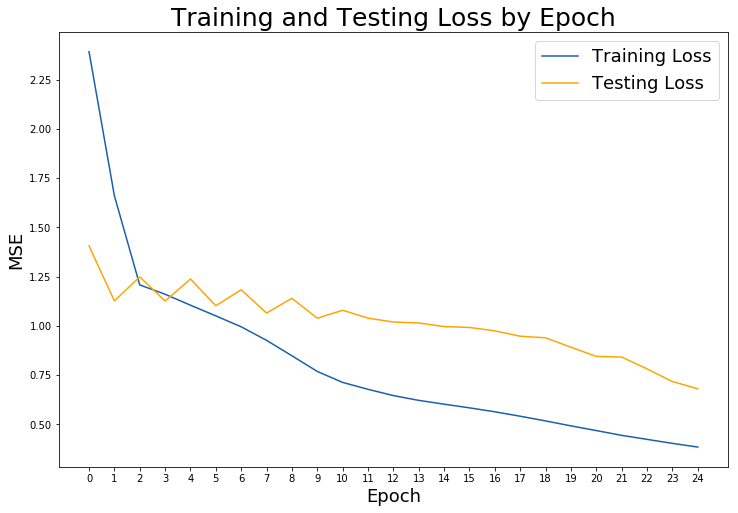

In [47]:
# Check out our train loss and test loss over epochs.
train_loss = history.history['loss']
test_loss = history.history['val_loss']

# Set figure size.
plt.figure(figsize=(12, 8))

# Generate line plot of training, testing loss over epochs.
plt.plot(train_loss, label='Training Loss', color='#185fad')
plt.plot(test_loss, label='Testing Loss', color='orange')

# Set title
plt.title('Training and Testing Loss by Epoch', fontsize = 25)
plt.xlabel('Epoch', fontsize = 18)
plt.ylabel('MSE', fontsize = 18)
plt.xticks(list(range(25)))

plt.legend(fontsize = 18);


In [36]:
# Evaluate model on test data.
cnn_score = cnn_model.evaluate(X_test,
                               Y_test,
                               verbose=1)

cnn_labels = cnn_model.metrics_names

# Compare models.

print(f'CNN 1 {cnn_labels[1]}  : {cnn_score[1]}')
print(f'CNN 1 {cnn_labels[2]}   : {cnn_score[2]}')
print(f'CNN 1 {cnn_labels[3]}   : {cnn_score[3]}')

print()

cnn_model.summary()

276/276 [==============================] - 28s 102ms/step
CNN 1 mean_squared_error  : 0.6804105341434479
CNN 1 mean_absolute_error   : 0.4601601293121559
CNN 1 r2_score   : 0.46896559950234235

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv3d_1 (Conv3D)            (None, 7, 97, 229, 6)     978       
_________________________________________________________________
max_pooling3d_1 (MaxPooling3 (None, 7, 24, 57, 6)      0         
_________________________________________________________________
conv3d_2 (Conv3D)            (None, 6, 16, 49, 16)     15568     
_________________________________________________________________
max_pooling3d_2 (MaxPooling3 (None, 6, 4, 12, 16)      0         
_________________________________________________________________
flatten_1 (Flatten)          (None, 4608)              0         
_________________________________________________________________
dense_1 (Dense

In [37]:
predictions = cnn_model.predict(X_test)

In [38]:
predictions.shape

(276, 24885)

In [40]:
prediction_3D = predictions.reshape(276, 105, 237)

In [42]:
Y_test = Y_test.reshape(276, 105, 237)

In [43]:
Y_train = Y_train.reshape(725, 105, 237)

Animation size has reached 21080167 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


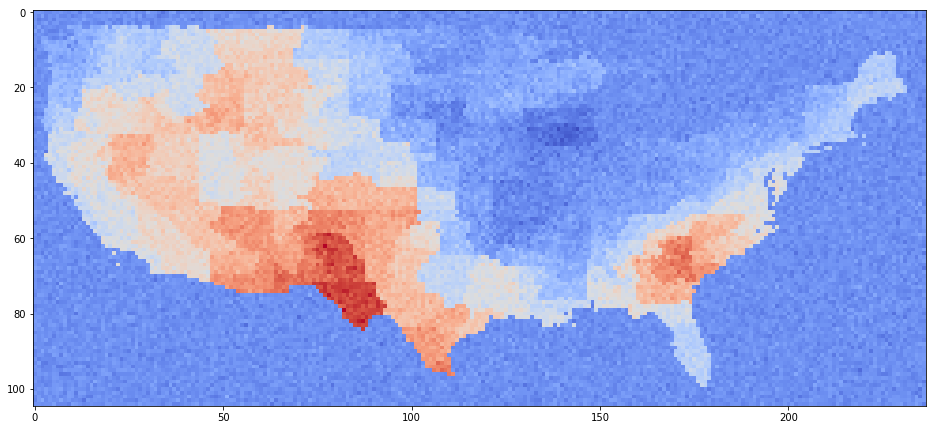

In [44]:
import matplotlib.animation as animation
from IPython.display import HTML

fig = plt.figure(figsize=(16, 12))

prediction_images = []
for i in range(len(prediction_3D)):
    prediction_image = plt.imshow(prediction_3D[i], animated=True, cmap="coolwarm");
    prediction_images.append([prediction_image])

ani = animation.ArtistAnimation(fig, prediction_images, interval=50, blit=True,
                            repeat_delay=1000)

# ani.save("./images/drought_data_timelapse.mp4")

from IPython.display import HTML
HTML(ani.to_jshtml())

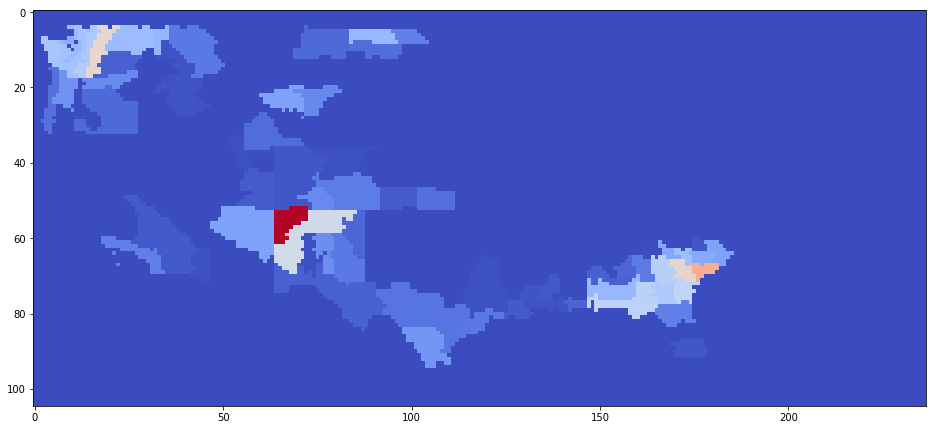

In [46]:
fig = plt.figure(figsize=(16, 12))

testing_images = []
for i in range(len(Y_test)):
    testing_image = plt.imshow(Y_test[i], animated=True, cmap="coolwarm")
    testing_images.append([testing_image])

ani = animation.ArtistAnimation(fig, testing_images, interval=35, blit=True,
                                repeat_delay=1000)

# ani.save("./images/drought_data_timelapse.mp4")

from IPython.display import HTML
HTML(ani.to_jshtml())